# Assert if the mesh alignment is correct

In [1]:
import os
import random
import numpy as np
import plotly.graph_objs as go
import cv2
from matplotlib import pyplot as plt
import torch
from PIL import Image
from tqdm import tqdm
import torchvision.transforms.functional as TF
import copy

In [2]:
root_dir = "./kuoyuan_home_glass"
rgb_path = os.path.join(root_dir, "rgb/ds")
store_world_canonical_mesh_path = os.path.join(root_dir, "mesh_canonical")
store_world_mesh_path = os.path.join(root_dir, "mesh_deformed")
store_world_mesh_reenact_path = os.path.join(root_dir, "mesh_reenact")
colmap_dir = os.path.join(root_dir, "colmap")

## Assertion project to image

In [ ]:
from nsrpl.colmap_utils import read_images_binary, read_cameras_binary

In [ ]:
imdata = read_images_binary(os.path.join(colmap_dir, 'sparse/0/images.bin'))

In [ ]:
def world2img_transform(mesh_deformed_world, w2c, K):
    # create camera intrinsic matrix
    mesh_deformed_world = torch.Tensor(mesh_deformed_world)
    # create camera extrinsic matrix
    extrinsic = torch.Tensor(copy.deepcopy(w2c)).float()
    results = []
    for mesh_point in mesh_deformed_world:
        mesh_point_exp = torch.cat([mesh_point, torch.ones([1])], dim=0)
        # transform the mesh to camera coordinate
        mesh_transformed_camera = torch.matmul(extrinsic, mesh_point_exp.T)
        # create the ones matrix
        ones = torch.Tensor([[1, 0, 0, 0],[0, 1, 0, 0],[0, 0, 1, 0]]).float()
        mesh_camera = torch.matmul(ones, mesh_transformed_camera)
        #mesh_camera_results.append(mesh_camera)
        pixels = torch.matmul(K, mesh_camera)
        results.append(pixels)
    results = torch.stack(results).float()
    results = results/results[:, 2, None]
    results = results.long()
    return results
    

In [ ]:
pick_num = 10
meshes = []
# get camera intrinsic matrix
camdata = read_cameras_binary(os.path.join(colmap_dir, 'sparse/0/cameras.bin'))
if camdata[1].model == 'SIMPLE_RADIAL':
    fx = fy = camdata[1].params[0]  # focal length
    cx = camdata[1].params[1]  # principal point
    cy = camdata[1].params[2]
elif camdata[1].model in ['PINHOLE', 'OPENCV']:
    fx = camdata[1].params[0] 
    fy = camdata[1].params[1] 
    cx = camdata[1].params[2] 
    cy = camdata[1].params[3] 
else:
    raise ValueError(f"Please parse the intrinsics for camera model {camdata[1].model}!")
K = torch.Tensor([[fx, 0, cx], [0, fy, cy], [0, 0, 1]]).float()


/tmp/ipykernel_281291/101722930.py:10: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matrices or `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at /opt/conda/conda-bld/pytorch_1682343967769/work/aten/src/ATen/native/TensorShape.cpp:3571.)
  mesh_transformed_camera = torch.matmul(extrinsic, mesh_point_exp.T)


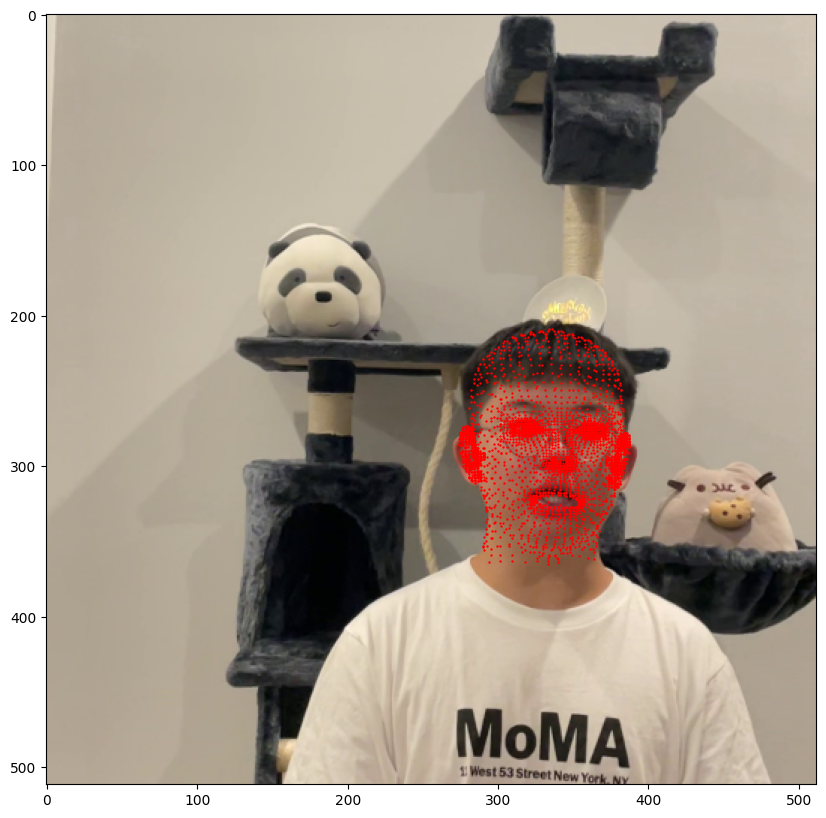

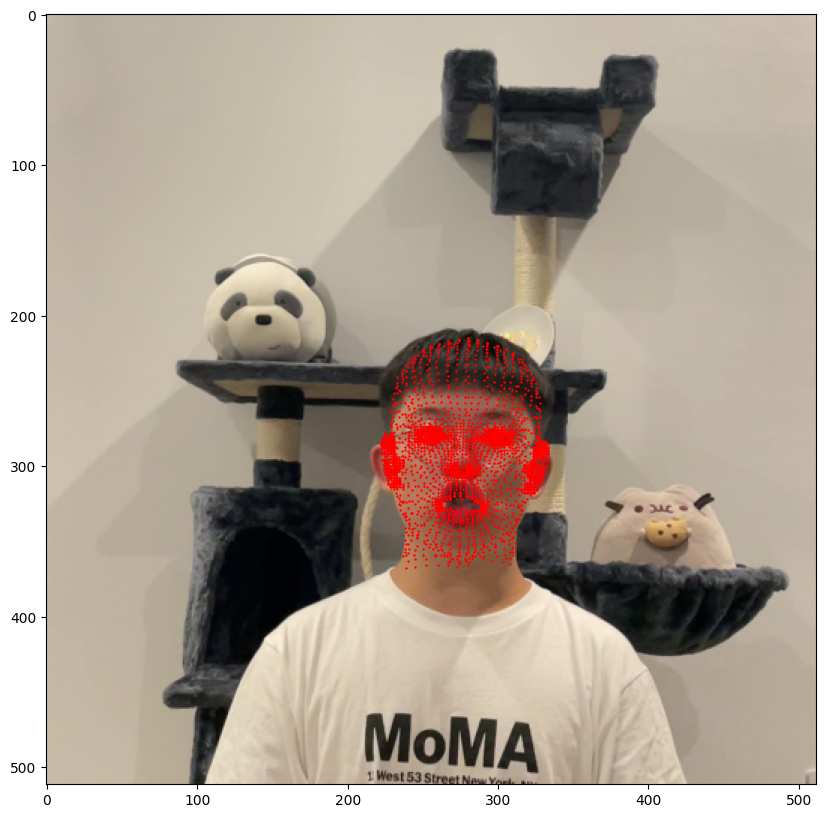

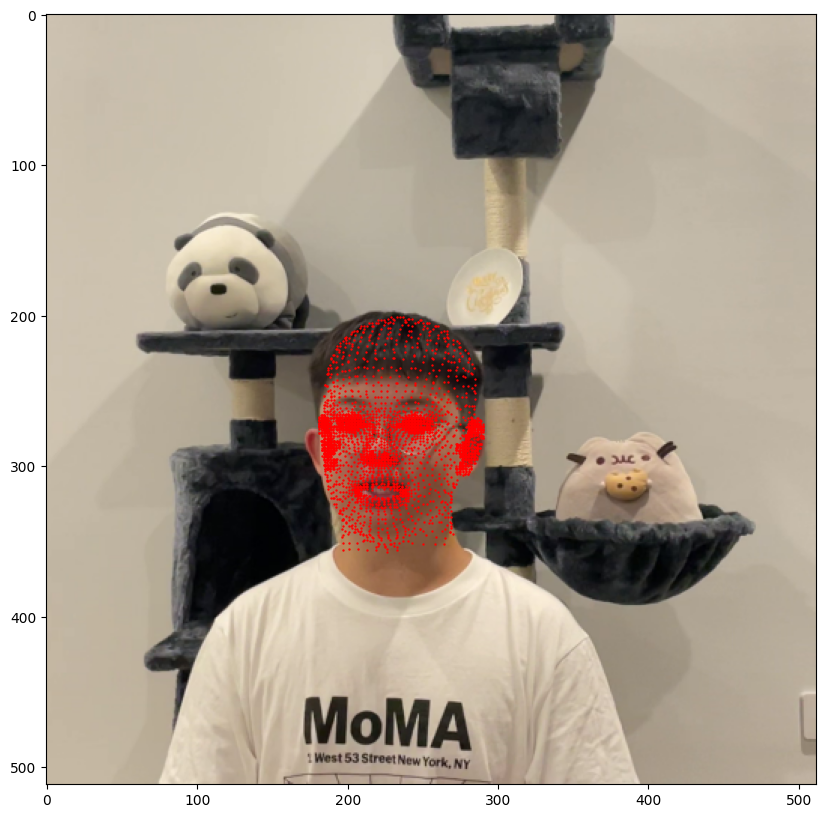

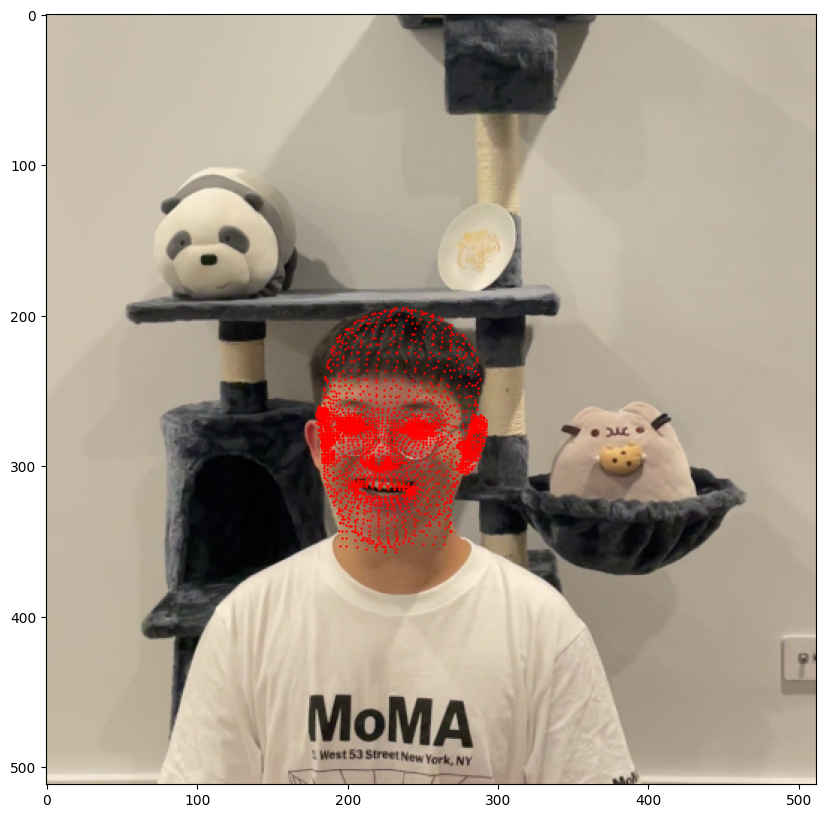

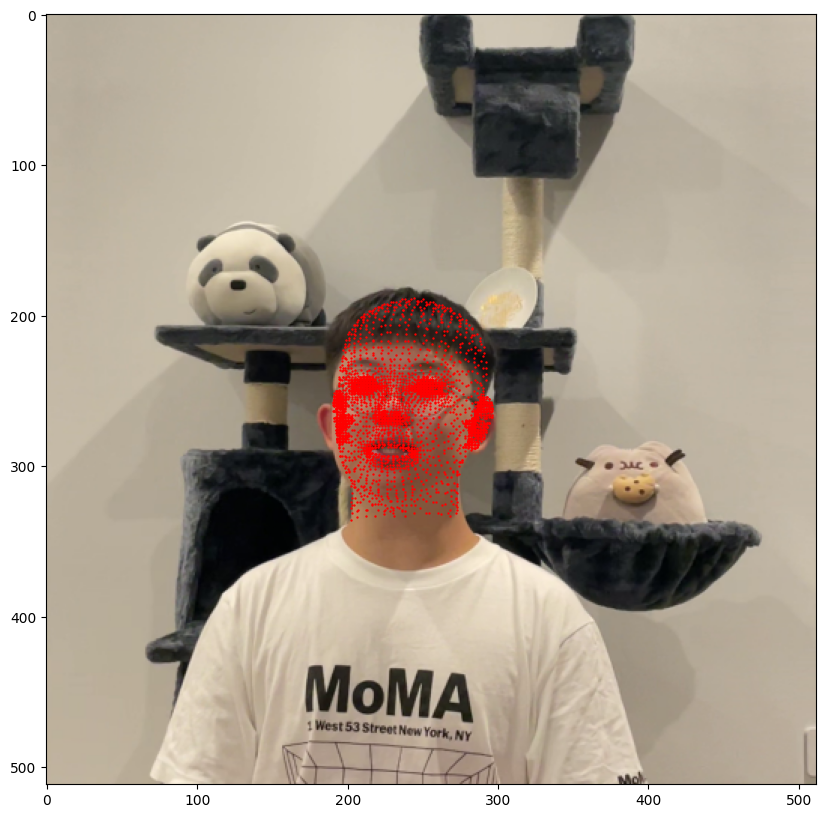

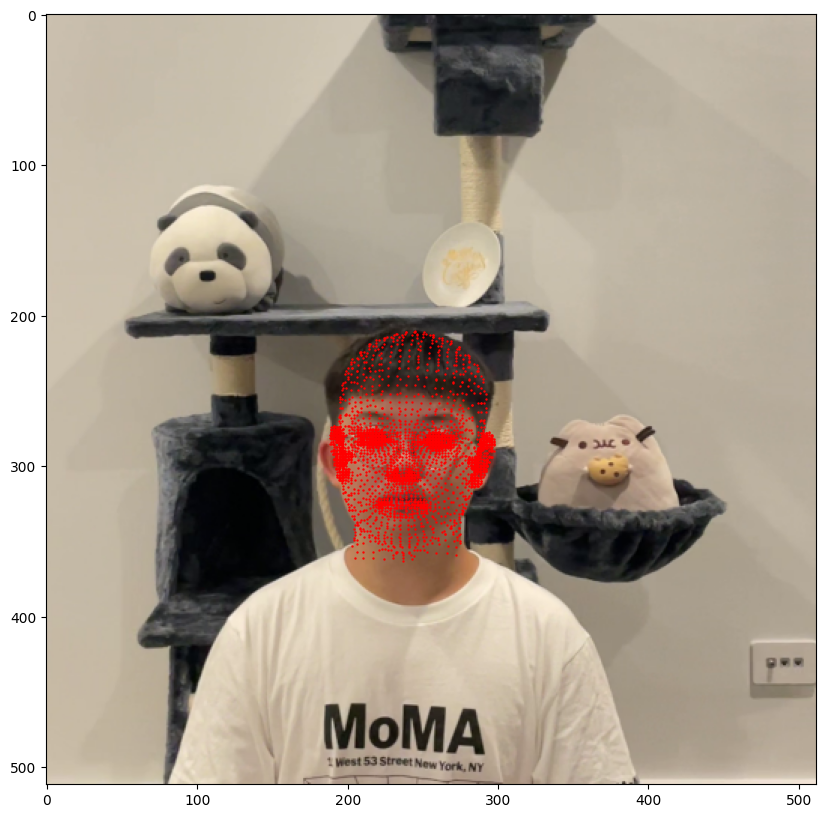

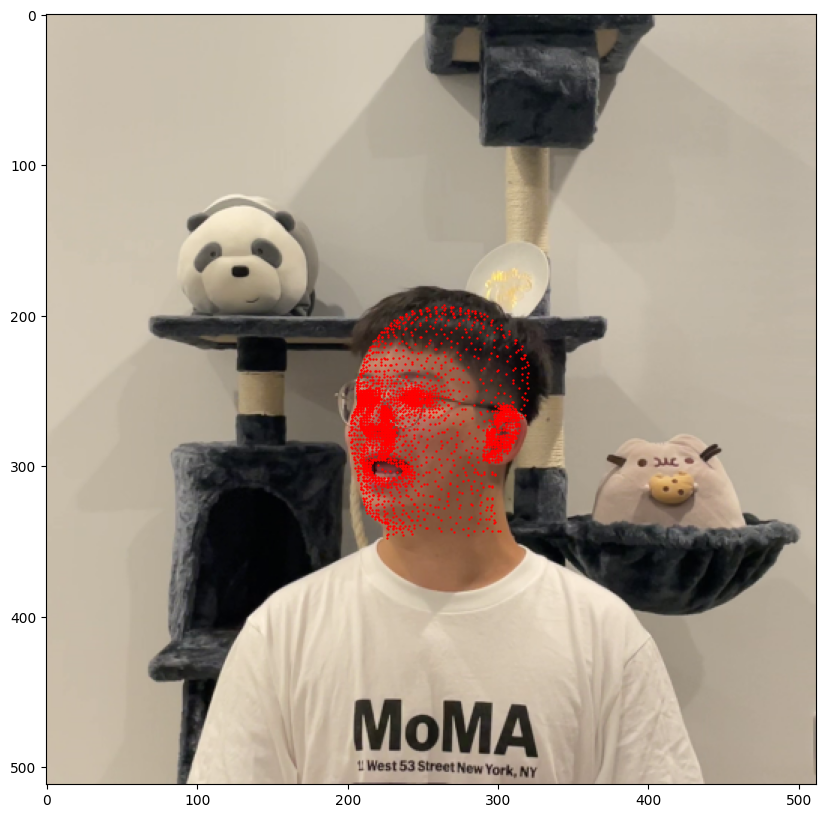

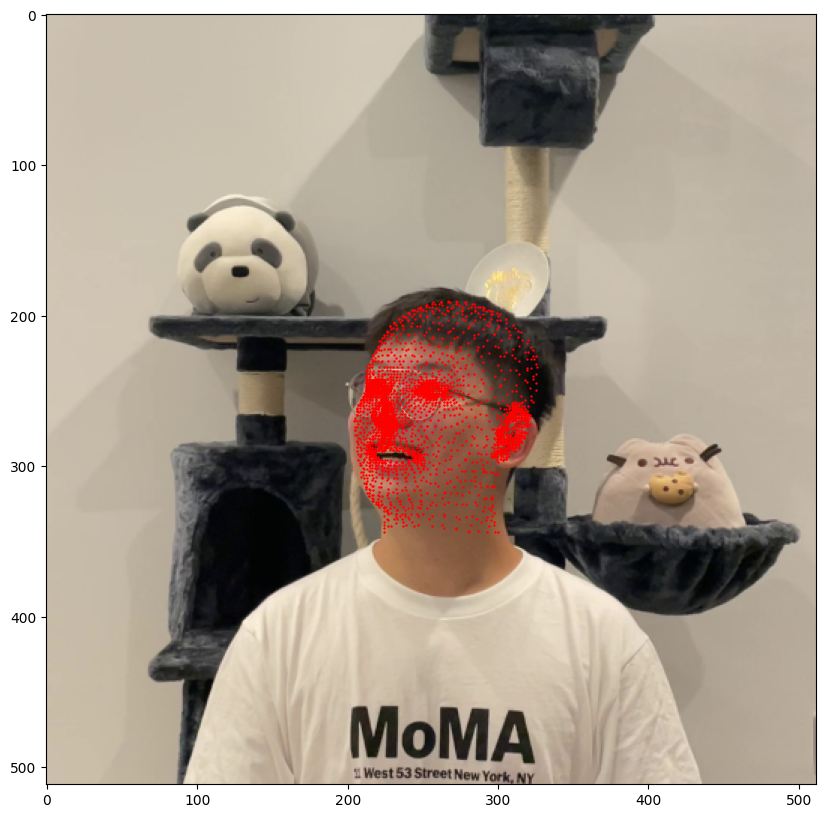

plot the transformed mesh and world canonical mesh for all 0 images


In [7]:
for i, d in enumerate(imdata.values()):
    # determine if we should use this image by random (10% chance)
    if random.random() > 0.005:
        continue
    image_name = d.name.split('.')[0] # px_00xxxx
    if not image_name.startswith(tuple(["p2","p3"])):
        continue
    print(image_name)
    # get world to camera matrix
    R = d.qvec2rotmat()
    t = d.tvec.reshape(3, 1)
    w2c = np.concatenate([R,t], axis=1)
    w2c = np.concatenate([w2c,[[0,0,0,1]]],axis = 0)
    w2c = torch.Tensor(w2c).float()    
    
    # load the mesh in the colmap world coordinate
    mesh_colmap = np.load(os.path.join(store_world_mesh_path, image_name+"_mesh_colmap_coordinate.npy"))
    meshes.append(mesh_colmap)
    mesh_img = world2img_transform(mesh_colmap, w2c, K)
    # load the image
    img = Image.open(os.path.join(rgb_path, image_name+".png"))
    img = TF.to_tensor(img).permute(1, 2, 0)[...,:3]
    # plot the image and mesh
    fig = plt.figure(figsize=(10, 10))
    plt.imshow(img)
    plt.scatter(mesh_img[:, 0], mesh_img[:, 1], c='r', s=0.5)
    plt.show()
                
    if len(meshes) > pick_num:
        break

print("plot the transformed mesh and world canonical mesh for all {} images".format(len(meshes)))    
# plot the transformed mesh and world canonical mesh
world_mesh = np.load(os.path.join(store_world_canonical_mesh_path, "canonical_mesh_colmap_coordinate.npy"))
fig = go.Figure()
for mesh in meshes:
    fig.add_trace(go.Scatter3d(
        x=mesh[:, 0],
        y=mesh[:, 1],
        z=mesh[:, 2],
        mode='markers',
        marker=dict(size=2),
    ))
fig.add_trace(go.Scatter3d(
    x=world_mesh[:, 0],
    y=world_mesh[:, 1],
    z=world_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
)) 
fig.update_layout(scene_dragmode='orbit')
fig.show()

## Check canonical, deform and reenact meshes

In [3]:
canonical_mesh = np.load(os.path.join(store_world_canonical_mesh_path, "canonical_mesh_colmap_coordinate.npy"))
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=canonical_mesh[:, 0],
    y=canonical_mesh[:, 1],
    z=canonical_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
))
# sample 10 deformed mesh
deformed_meshes_list = os.listdir(store_world_mesh_path)
selected_deformed_meshes = random.sample(deformed_meshes_list, 10)
for selected_deformed_mesh_path in selected_deformed_meshes:
    deform_mesh = np.load(os.path.join(store_world_mesh_path,selected_deformed_mesh_path))
    fig.add_trace(go.Scatter3d(
        x=deform_mesh[:, 0],
        y=deform_mesh[:, 1],
        z=deform_mesh[:, 2],
        mode='markers',
        marker=dict(size=2),
    ))

# sample 10 reenactment mesh
reenact_meshes_list = os.listdir(store_world_mesh_reenact_path)
selected_reenact_meshes = random.sample(reenact_meshes_list, 10)
for selected_reenact_mesh_path in selected_reenact_meshes:
    reenact_mesh = np.load(os.path.join(store_world_mesh_reenact_path,selected_reenact_mesh_path))
    fig.add_trace(go.Scatter3d(
        x=reenact_mesh[:, 0],
        y=reenact_mesh[:, 1],
        z=reenact_mesh[:, 2],
        mode='markers',
        marker=dict(size=2),
    ))
fig.update_layout(scene_dragmode='orbit')
fig.show()
